# <font>About Dataset</font>

## <font>Content</font>
This data set contains details of a bank's customers and the target variable is a binary variable reflecting the fact whether the customer left the bank (closed his account) or he continues to be a customer.

## <font>Variables</font>

* RowNumber: Row Numbers from 1 to 10000
* CustomerId: Unique Ids for bank customer identification
* Surname: Customer's last name
* CreditScore: Credit score of the customer
* Geography: The country from which the customer belongs
* Gender: Male or Female
* Age: Age of the customer
* Tenure: Number of years for which the customer has been with the bank
* Balance: Bank balance of the customer
* NumOfProducts: Number of bank products the customer is utilising
* HasCrCard: Binary Flag for whether the customer holds a credit card with the bank or not
* IsActiveMember: Binary Flag for whether the customer is an active member with the bank or not
* EstimatedSalary: Estimated salary of the customer in Dollars
* Exited: Binary flag 1 if the customer closed account with bank and 0 if the customer is retained

In [2]:
import seaborn as sns
import seaborn.objects as so
import matplotlib as mpl
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import pandas_profiling

## <font color='blue'>Análise do banco de dados</font>

In [3]:
df = pd.read_csv('C:/Users/Boffo/CoderHouse/Churn_Modelling.csv', encoding= 'ISO-8859-1')
df.head(10)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0
5,6,15574012,Chu,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1
6,7,15592531,Bartlett,822,France,Male,50,7,0.00,2,1,1,10062.80,0
7,8,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1
8,9,15792365,He,501,France,Male,44,4,142051.07,2,0,1,74940.50,0
9,10,15592389,H?,684,France,Male,27,2,134603.88,1,1,1,71725.73,0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [6]:
#Transformação das váriáveis binárias para variáveis categóricas
df.HasCrCard = df.HasCrCard.replace({0:'Non_CredCard',1:'CredCard'})
df.IsActiveMember = df.IsActiveMember.replace({0:'Non_ActiveMember',1:'ActiveMember'})
df.Exited = df.Exited.replace({0:'Non_Exited',1:'Exited'})
df.head(10)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,CredCard,ActiveMember,101348.88,Exited
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,Non_CredCard,ActiveMember,112542.58,Non_Exited
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,CredCard,Non_ActiveMember,113931.57,Exited
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,Non_CredCard,Non_ActiveMember,93826.63,Non_Exited
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,CredCard,ActiveMember,79084.10,Non_Exited
5,6,15574012,Chu,645,Spain,Male,44,8,113755.78,2,CredCard,Non_ActiveMember,149756.71,Exited
6,7,15592531,Bartlett,822,France,Male,50,7,0.00,2,CredCard,ActiveMember,10062.80,Non_Exited
7,8,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,CredCard,Non_ActiveMember,119346.88,Exited
8,9,15792365,He,501,France,Male,44,4,142051.07,2,Non_CredCard,ActiveMember,74940.50,Non_Exited
9,10,15592389,H?,684,France,Male,27,2,134603.88,1,CredCard,ActiveMember,71725.73,Non_Exited


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  object 
 11  IsActiveMember   10000 non-null  object 
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  object 
dtypes: float64(2), int64(6), object(6)
memory usage: 1.1+ MB


In [177]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
RowNumber,10000.0,5.000500e+03,2886.895680,1.00,2500.75,5.000500e+03,7.500250e+03,10000.00
CustomerId,10000.0,1.569094e+07,71936.186123,15565701.00,15628528.25,1.569074e+07,1.575323e+07,15815690.00
CreditScore,10000.0,6.505288e+02,96.653299,350.00,584.00,6.520000e+02,7.180000e+02,850.00
Age,10000.0,3.892180e+01,10.487806,18.00,32.00,3.700000e+01,4.400000e+01,92.00
Tenure,10000.0,5.012800e+00,2.892174,0.00,3.00,5.000000e+00,7.000000e+00,10.00
Balance,10000.0,7.648589e+04,62397.405202,0.00,0.00,9.719854e+04,1.276442e+05,250898.09
NumOfProducts,10000.0,1.530200e+00,0.581654,1.00,1.00,1.000000e+00,2.000000e+00,4.00
EstimatedSalary,10000.0,1.000902e+05,57510.492818,11.58,51002.11,1.001939e+05,1.493882e+05,199992.48


## <font color='blue'>Análise Univariada</font>

<AxesSubplot:xlabel='Gender', ylabel='count'>

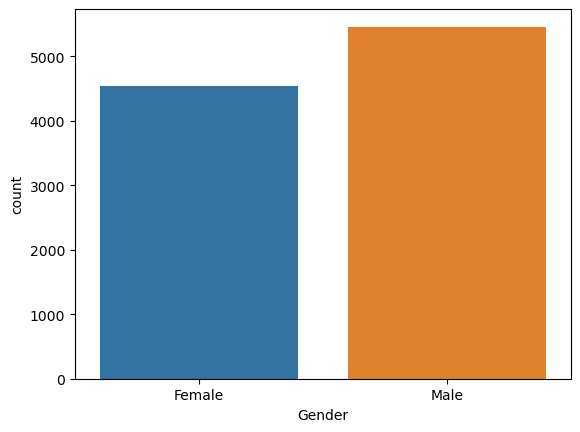

In [178]:
#Qual a quantidade de homens e mulheres? 
# Análise: quantidade de usuários majoritariamento masculina.
sns.countplot(x=df["Gender"])

<AxesSubplot:xlabel='NumOfProducts', ylabel='count'>

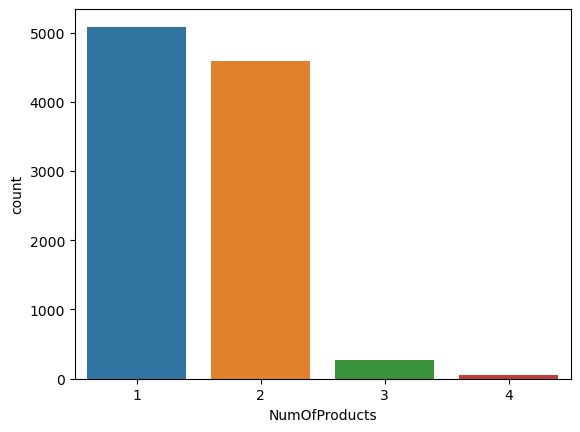

In [215]:
#Qual a quantidade de cada produto utilizado pelos clientes?
# Análise: quantidade de clinete com 1 ou 2 produtos maior do que com 3 ou 4.
sns.countplot(x=df["NumOfProducts"])

<AxesSubplot:xlabel='Tenure', ylabel='count'>

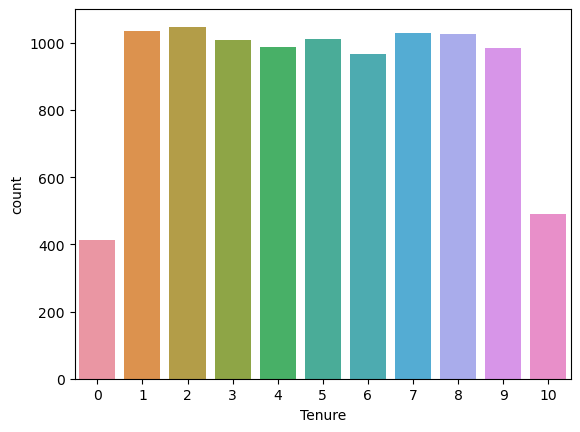

In [216]:
#Qual a quantidade de pessoas separado pelo tempo que são clientes do banco? 
# Análise: o período entre 1 a 9 anos possui uma quantidade de clientes equilibrada e clientes com menos de 1 ano e 10 anos não são expressivos.
sns.countplot(x=df["Tenure"])

<AxesSubplot:>

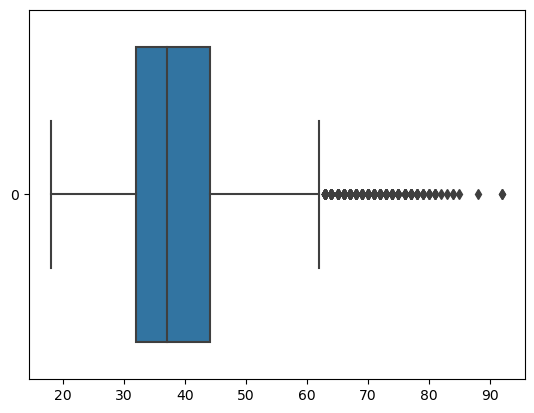

In [181]:
#Como está a dispersão das idades dos clientes?
# Análise: Mediana está em torno de 38 anos e o maior quartil está em torno dos 40 anos.
sns.boxplot(df.Age, orient="h")

<AxesSubplot:xlabel='Age', ylabel='count'>

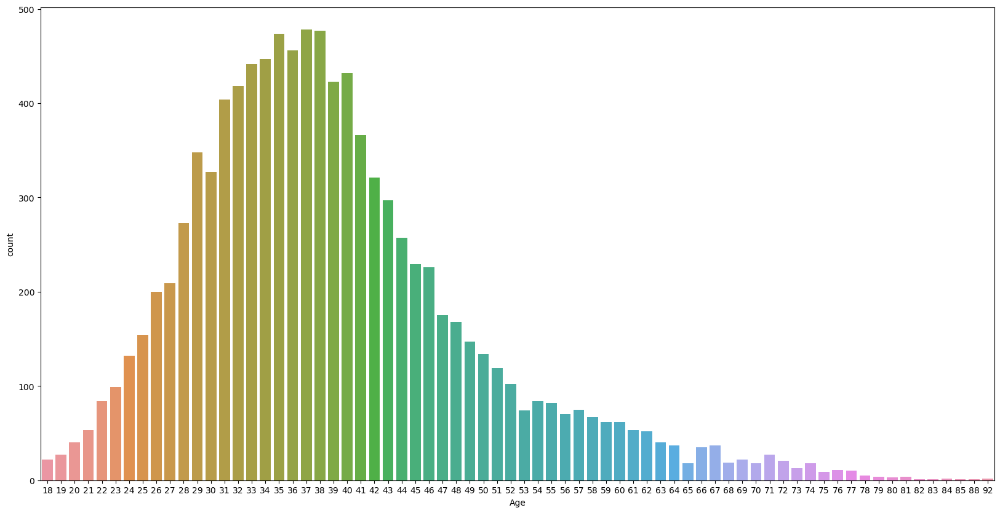

In [217]:
#Qual a quantidade de clientes por faixa etária?
# Análise: Maior parte dos clientes estão na faixa de 31 a 40 anos de idade.
plt.figure(figsize=(20,10))
sns.countplot(x=df["Age"])

## <font color='blue'>Análise Bivariada</font>

<AxesSubplot:xlabel='Age', ylabel='Gender'>

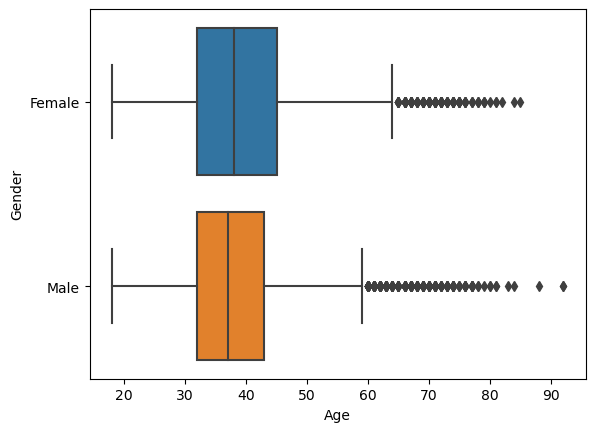

In [183]:
#Como está a dispersão das idades dos clientes separado por gênero?
# Análise: A faixa de idade entre os gêneros estão praticamente iguais. 
sns.boxplot(data=df, x="Age", y="Gender", orient="h")

<AxesSubplot:xlabel='Age', ylabel='count'>

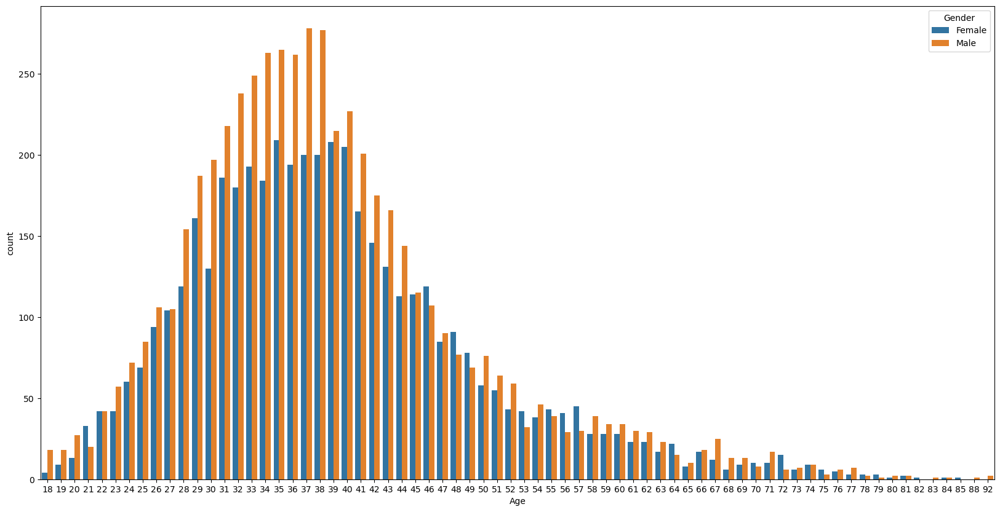

In [185]:
#Qual a quantidade de clientes por faixa etária separado por gênero?
# Análise: A curva normal mantem a mesma curvatura nos dois gêneros. 
plt.figure(figsize=(20,10))
sns.countplot(data=df, x="Age", hue="Gender")

<AxesSubplot:xlabel='Tenure', ylabel='Exited'>

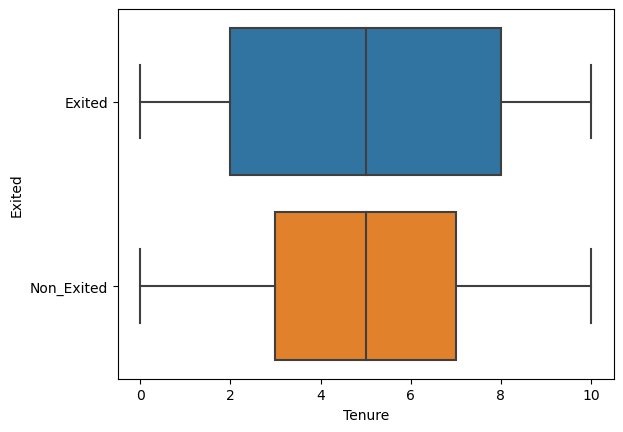

In [220]:
#Qual a dispersão das pessoas que deixaram ou não o banco com relação ao tempo que são clientes?
# Análise: Existe uma concentração de clientes que permaneceram na faixa entre 3 a 7 anos. Já os clientes que saíram, estão numa faixa maior, de 2 a 8 anos.
sns.boxplot(data=df, x="Tenure", y="Exited", orient="h")

<AxesSubplot:xlabel='Age', ylabel='Exited'>

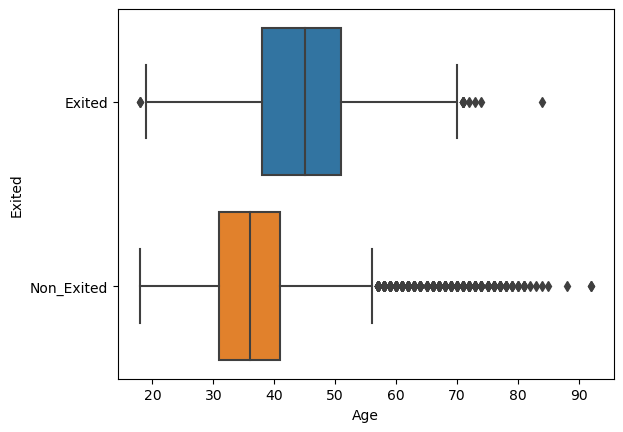

In [221]:
#Qual a dispersão das pessoas que deixaram ou não o banco com relação à suas idades?
# Análise: A faixa etária entre 40 a 50 anos demonstrou uma evasão maior e a faixa entre 30 a 40 anos demonstrou maior permanência.
sns.boxplot(data=df, x="Age", y="Exited", orient="h")

<AxesSubplot:xlabel='count', ylabel='Gender'>

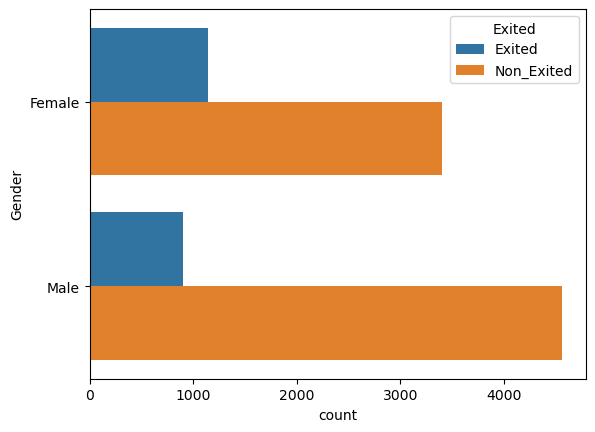

In [222]:
#Qual o gênero que mais deixou e qual que mais permaneceu cliente do banco?
# Análise: O público feminino demonstra ter uma maior proporção de saídas, já o público masculino, possui maior retenção.  
sns.countplot(data=df, y="Gender", hue="Exited")

<AxesSubplot:xlabel='count', ylabel='Geography'>

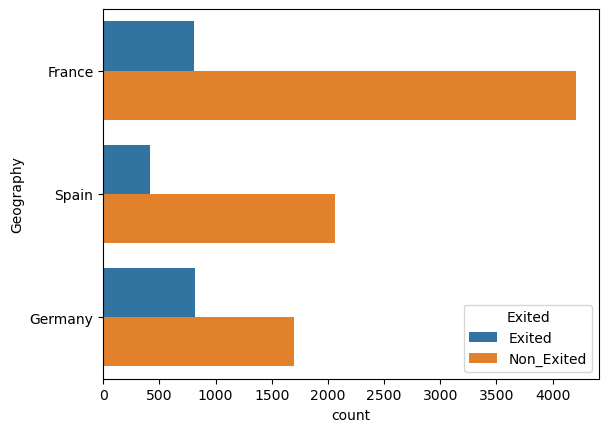

In [223]:
#Qual o país que mais reteve clientes?
# Análise: Podemos analisar que a Alemanha possui menor quantidade de clientes no total e maior número de evasão. Ao contrário da Alemanha, a França tem mais clientes e maior retenção.
sns.countplot(data=df, y="Geography", hue="Exited")

<AxesSubplot:xlabel='count', ylabel='Geography'>

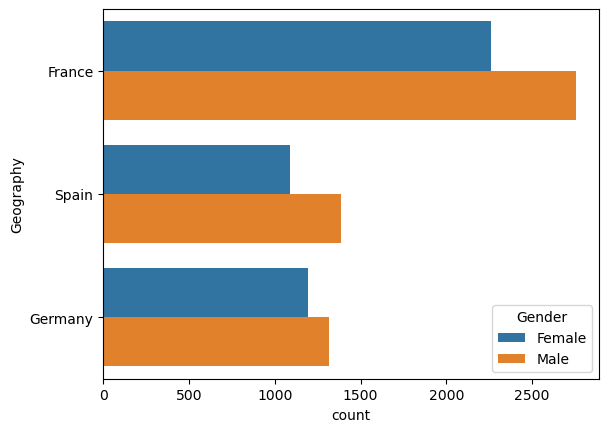

In [224]:
#Qual país tem mais clientes separados por gênero? 
# Análise: França possui mais clientes nos dois gêneros.
sns.countplot(data=df, y="Geography", hue="Gender")

In [8]:
#Qual a média de salários por país?
# Análise: Observamos um equilíbrio salarial entre os países.
df.groupby('Geography')['EstimatedSalary'].mean().sort_values(ascending=False)

Geography
Germany    101113.435102
France      99899.180814
Spain       99440.572281
Name: EstimatedSalary, dtype: float64

In [228]:
#Qual a média, mín e máx do Credit Score separados pelo tempo de conta no banco?
# Análise: Credit Score possui uma média constante entre os anos.
df.groupby('Tenure')['CreditScore'].describe()

,count,mean,std,min,25%,50%,75%,max
Tenure,,,,,,,,
0,413.0,652.043584,96.408808,350.0,590.0,653.0,717.00,850.0
1,1035.0,648.806763,96.227373,350.0,578.0,652.0,717.00,850.0
2,1048.0,652.832061,96.353984,399.0,588.0,654.0,717.25,850.0
3,1009.0,650.530228,97.458861,350.0,581.0,650.0,716.00,850.0
4,989.0,651.502528,95.742143,351.0,583.0,651.0,718.00,850.0
5,1012.0,650.527668,96.422651,395.0,584.0,654.0,721.00,850.0
6,967.0,647.380558,98.912565,359.0,581.5,648.0,718.00,850.0
7,1028.0,649.606031,95.577970,373.0,586.0,650.0,717.00,850.0
8,1025.0,647.749268,97.443326,358.0,583.0,649.0,710.00,850.0


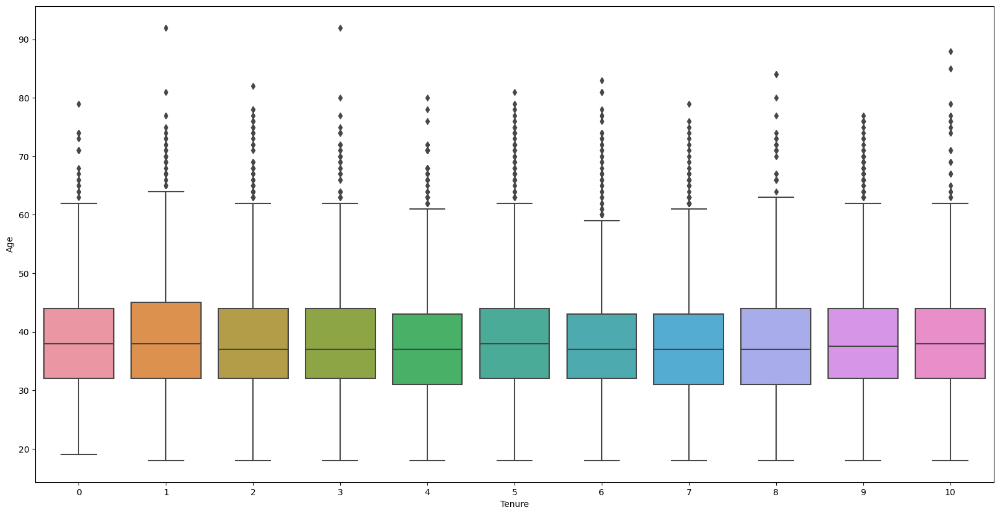

In [229]:
#Qual a dispersão das idades dos clientes separados pelo tempo de conta no banco?
# Análise: A faixa etária está entre 33 a 45 anos e se mantém ao longo dos anos de permanência no banco.
plt.figure(figsize=(20,10))
sns.boxplot(data = df, y = 'Age', x = 'Tenure')
plt.show()

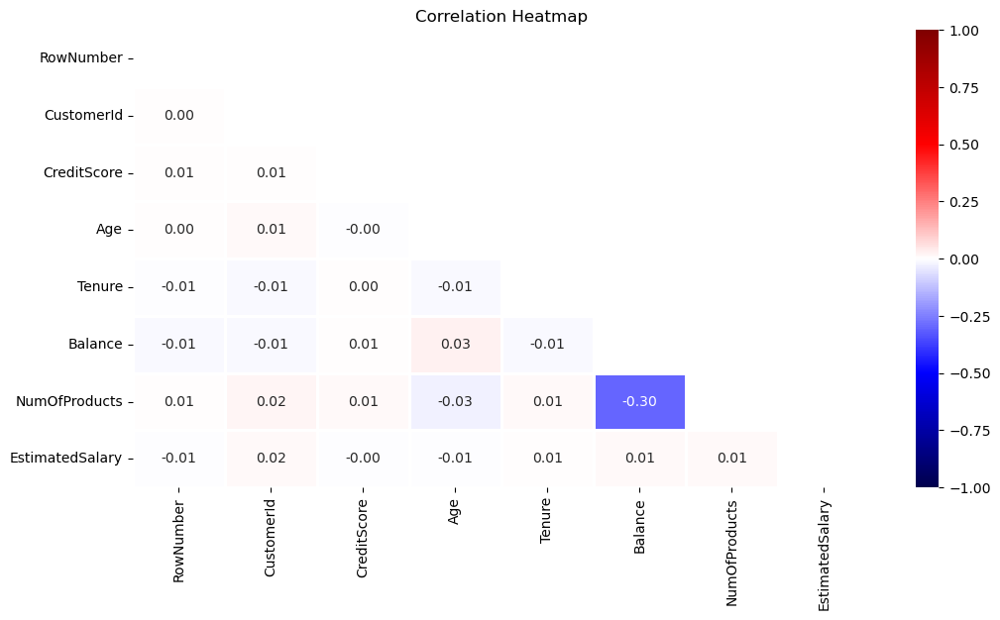

In [10]:
#Qual a correlação entre a variáveis?
# Análise: A maior correlação entre as variáveis é a correlação negativa entre o número de produtos e o saldo em conta, porém essa correlação é baixa.
plt.figure(figsize=(12, 6))
mask = np.triu(np.ones_like(df.corr(),dtype = bool))
sns.heatmap(df.corr(),mask = mask, fmt = ".2f",annot=True,lw=1,cmap = 'seismic',vmin=-1, vmax=1)
plt.yticks(rotation = 0)
plt.xticks(rotation = 90)
plt.title('Correlation Heatmap')
plt.show()

In [11]:
profile = pandas_profiling.ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### <font color='blue'>Análise Multivariada</font>

<AxesSubplot:xlabel='Geography', ylabel='Age'>

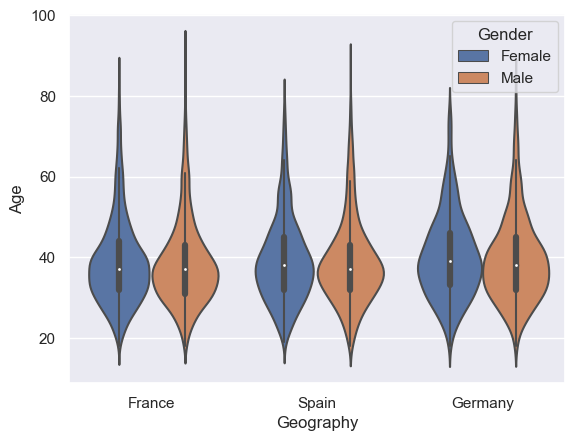

In [240]:
#Qual o perfil de idade por gênero de cada país?
# Análise: O perfil de idade se mantém entre os países e o gêneros.
sns.violinplot(data=df, x="Geography", y="Age", hue="Gender")

<AxesSubplot:xlabel='Geography', ylabel='Age'>

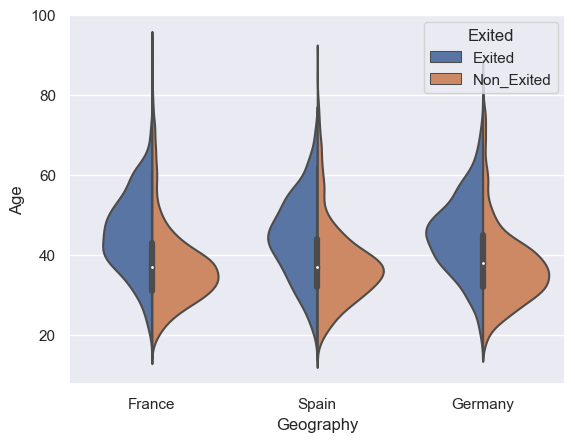

In [301]:
#Qual o perfil de idade das pessoas que deixaram o banco separado por país?
# Análise: Existe uma diferença de faixa etária entre os clientes que saíram e que permaneceram, sendo que os que deixaram o banco possuem uma faixa etária maior e permanece o mesmo perfil entre os países.
sns.violinplot(data=df, x="Geography", y="Age", hue="Exited", split=True)

<AxesSubplot:xlabel='Gender', ylabel='Age'>

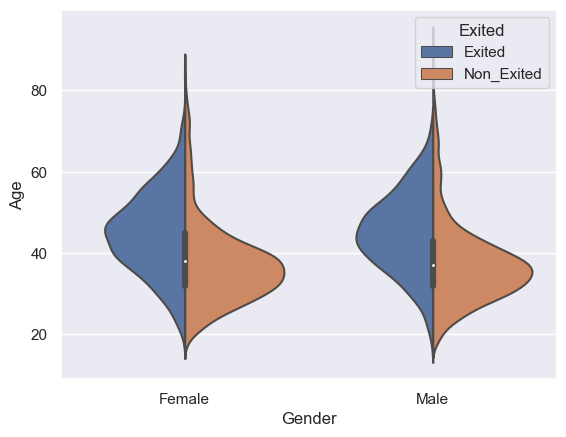

In [287]:
#Qual o perfil de idade das pessoas que deixaram o banco separado gênero?
# Análise: Faixa etária de retençaõ e evasão permanece a mesmo entre os gêneros, sendo a faixa etária maior de saída e a menor de retenção.
sns.violinplot(data=df, x="Gender", y="Age", hue="Exited", split=True)

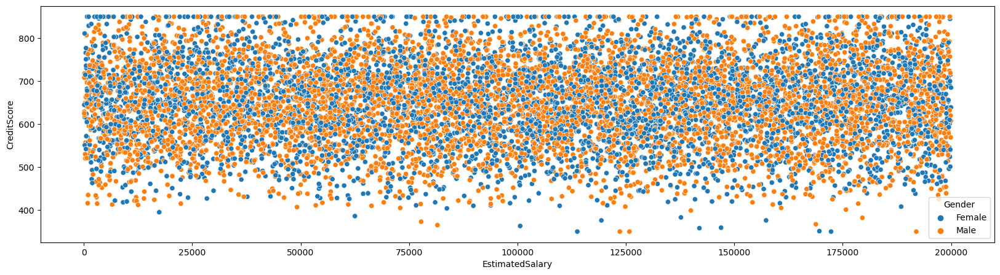

In [231]:
#Qual a dispersão entre o salário e o Credit Score por gênero?
# Análise: Sem conclusões.
plt.figure(figsize=(20,5))
sns.scatterplot(x='EstimatedSalary', y='CreditScore', data=df, hue='Gender')
plt.show()

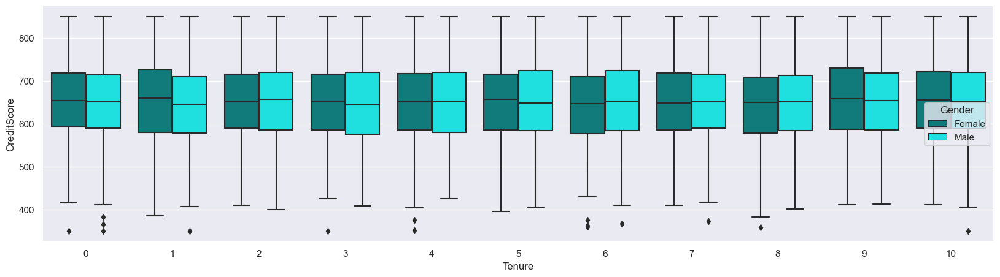

In [239]:
#Qual a dispersão do Credit Score por gênero separado pelo tempo de conta no banco?
# Análise: Os dois gêneros possuem a mesma faixa de pontuação de score durante os anos de permanência no banco.
plt.figure(figsize=(20,5))
sns.boxplot(x = 'Tenure', y = "CreditScore", data = df, hue = 'Gender', palette = ['#008B8B','#00FFFF'])
plt.show()

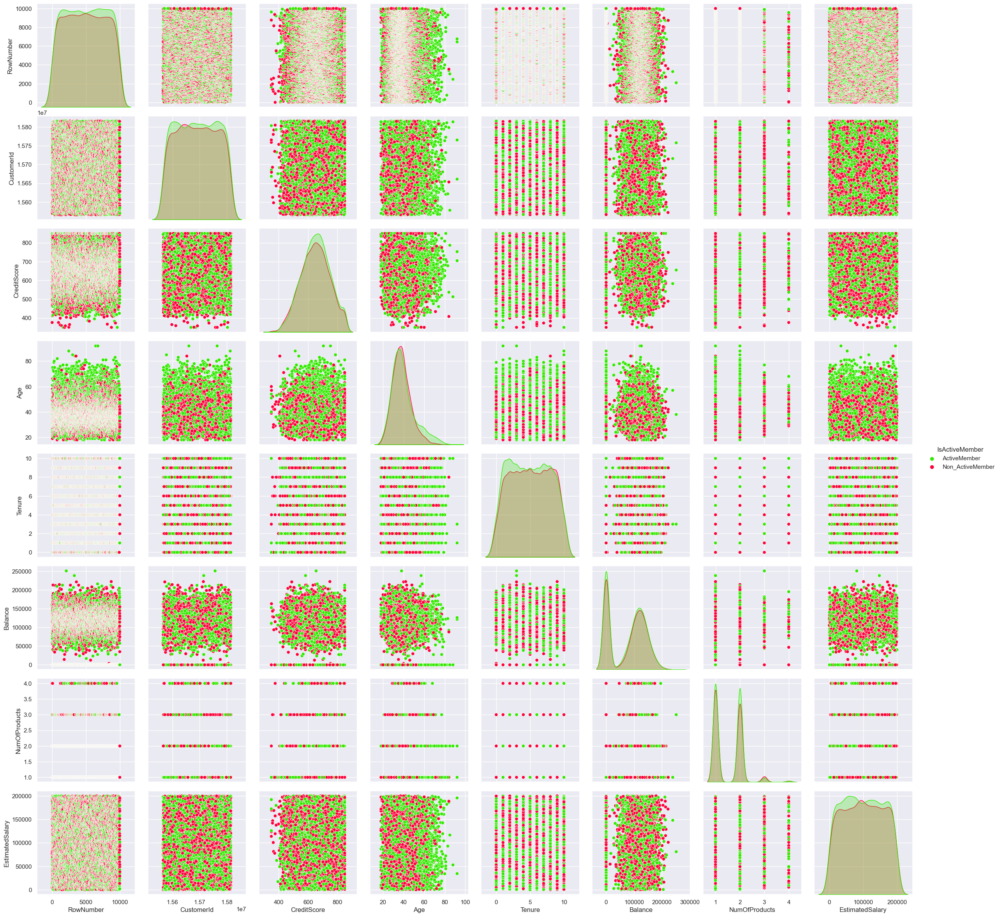

In [268]:
#Análise da dispersão e histograma entre as variáveis, evidenciando se a pessoa é um cliente ativo ou não.
# Análise: Não identificamos nenhuma relação entre as variáveis com relação a clientes ativos e inativos. 
sns.pairplot(df,hue = 'IsActiveMember' , height = 3 , palette = 'prism')

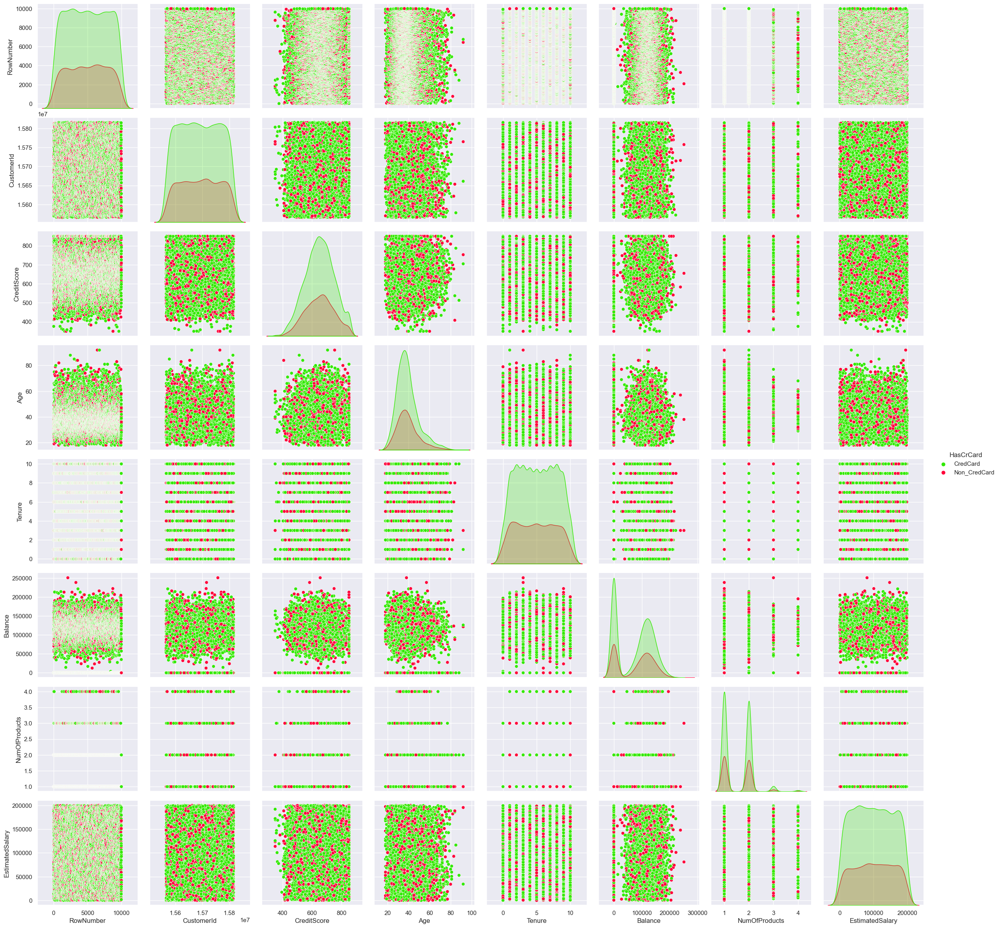

In [267]:
#Análise da dispersão e histograma entre as variáveis, evidenciando se o cliente tem cartão de crédito ou não.
#Análise: Não identificamos nenhuma relação entre as variáveis com relação a clientes que possuem cartão de crédito ou não.
sns.pairplot(df,hue = 'HasCrCard' , height = 3 , palette = 'prism')

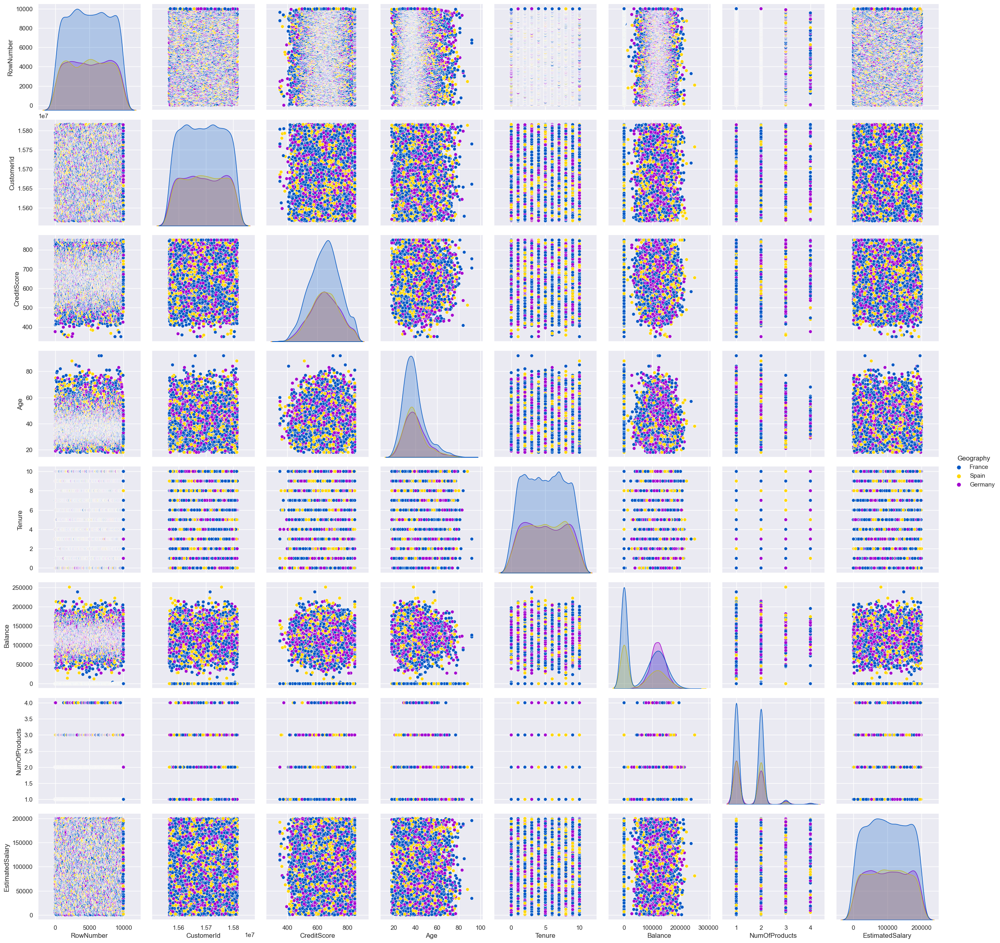

In [266]:
#Análise da dispersão e histograma entre as variáveis, evidenciando dados de cada país.
#Análise: Não identificamos nenhuma relação entre as variáveis com relação aos países dos clientes.
sns.pairplot(df,hue = 'Geography' , height = 3 , palette = 'prism')